# P2-Lab1: Converting Raw Text into Sequence Data

We are going to load raw text, convert into tokens and indexed sequences, and perform some statistical analysis.


In [1]:
!pip install d2l==1.0.0a0
!pip install Unidecodeimport collections
!pip install torch
!pip install torchvision
!pip install scipy
import random
import re
import torch
from d2l import torch as d2l


[notice] A new release of pip is available: 25.2 -> 25.3
[notice] To update, run: pip install --upgrade pip
ERROR: Could not find a version that satisfies the requirement Unidecodeimport (from versions: none)

[notice] A new release of pip is available: 25.2 -> 25.3
[notice] To update, run: pip install --upgrade pip
ERROR: No matching distribution found for Unidecodeimport

[notice] A new release of pip is available: 25.2 -> 25.3
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 25.2 -> 25.3
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 25.2 -> 25.3
[notice] To update, run: pip install --upgrade pip


## The Dataset

We will work with H. G. Wells'
[The Time Machine](http://www.gutenberg.org/ebooks/35),
a book containing just over 30,000 words.
The following `_download` method
(**reads the raw text into a string**).


In [2]:
class TimeMachine(d2l.DataModule): #@save
    """The Time Machine dataset."""
    def _download(self):
        fname = d2l.download(d2l.DATA_URL + 'timemachine.txt', self.root,
                             '090b5e7e70c295757f55df93cb0a180b9691891a')
        with open(fname) as f:
            return f.read()

data = TimeMachine()
raw_text = data._download()
raw_text[:60]

'The Time Machine, by H. G. Wells [1898]\n\n\n\n\nI\n\n\nThe Time Tra'

For simplicity, we ignore punctuation and capitalization when preprocessing the raw text.


We show the first 60 characters preprocessed.

In [3]:
@d2l.add_to_class(TimeMachine)  #@save
def _preprocess(self, text):
    return re.sub('[^A-Za-z]+', ' ', text).lower()

text = data._preprocess(raw_text)
text[:60]

'the time machine by h g wells i the time traveller for so it'

## Tokenization

*Tokens* are the atomic (indivisible) units of text.
Each time step corresponds to 1 token,
but what precisely constitutes a token is a **design** choice.

Below, we tokenize our preprocessed text
into a sequence of **characters**.


In [4]:
@d2l.add_to_class(TimeMachine)  #@save
def _tokenize(self, text):
    return list(text)

tokens = data._tokenize(text)
','.join(tokens[:30])

't,h,e, ,t,i,m,e, ,m,a,c,h,i,n,e, ,b,y, ,h, ,g, ,w,e,l,l,s, '

## Vocabulary

These tokens are still strings.
However, the inputs to our models
must consist
of numerical inputs.
First, we determine the set of unique tokens in our training *corpus*.
We then assign a numerical index to each unique token.
Rare vocabulary elements are often dropped for convenience.
Whenever we encounter a token that had not been previously seen,
we represent it by a special "&lt;unk&gt;" token,
signifying that this is an *unknown* value.


In [5]:
import collections

class Vocab:  #@save
    """Vocabulary for text."""
    def __init__(self, tokens=[], min_freq=0, reserved_tokens=[]):
        # Flatten a 2D list if needed
        if tokens and isinstance(tokens[0], list):
            tokens = [token for line in tokens for token in line]
        # Count token frequencies
        counter = collections.Counter(tokens)
        self.token_freqs = sorted(counter.items(), key=lambda x: x[1],
                                  reverse=True)
        # The list of unique tokens
        self.idx_to_token = list(sorted(set(['<unk>'] + reserved_tokens + [
            token for token, freq in self.token_freqs if freq >= min_freq])))
        self.token_to_idx = {token: idx
                             for idx, token in enumerate(self.idx_to_token)}

    def __len__(self):
        return len(self.idx_to_token)

    def __getitem__(self, tokens):
        if not isinstance(tokens, (list, tuple)):
            return self.token_to_idx.get(tokens, self.unk)
        return [self.__getitem__(token) for token in tokens]

    def to_tokens(self, indices):
        if hasattr(indices, '__len__') and len(indices) > 1:
            return [self.idx_to_token[int(index)] for index in indices]
        return self.idx_to_token[indices]

    @property
    def unk(self):  # Index for the unknown token
        return self.token_to_idx['<unk>']

We now [**construct a vocabulary**] for our dataset,
converting the sequence of strings
into a list of numerical indices.
Note that we have not lost any information
and can easily convert our dataset
back to its original (string) representation.


In [6]:
vocab = Vocab(tokens)
indices = vocab[tokens[:10]]
print('indices:', indices)
print('words:', vocab.to_tokens(indices))

indices: [21, 9, 6, 0, 21, 10, 14, 6, 0, 14]
words: ['t', 'h', 'e', ' ', 't', 'i', 'm', 'e', ' ', 'm']


## Putting It All Together

Using the above classes and methods,
we [**package everything into the following
`build` method of the `TimeMachine` class**],
which returns `corpus`, a list of token indices, and `vocab`,
the vocabulary of *The Time Machine* corpus.
The modifications we did here are:
(i) we tokenize text into characters, not words,
to simplify the training in later sections;
(ii) `corpus` is a single list, not a list of token lists,
since each text line in *The Time Machine* dataset
is not necessarily a sentence or paragraph.


In [7]:
@d2l.add_to_class(TimeMachine)  #@save
def build(self, raw_text, vocab=None):
    tokens = self._tokenize(self._preprocess(raw_text))
    if vocab is None: vocab = Vocab(tokens)
    corpus = [vocab[token] for token in tokens]
    return corpus, vocab

corpus, vocab = data.build(raw_text)
len(corpus), len(vocab)

(173428, 28)

## Exploratory Language Statistics

Using the real corpus and the `Vocab` class defined over words,
we can inspect basic statistics concerning word use in our corpus.
Below, we construct a vocabulary from words used in *The Time Machine*
and print the ten most frequently occurring of them.


In [8]:
words = text.split()
vocab = Vocab(words)
vocab.token_freqs[:10]

[('the', 2261),
 ('i', 1267),
 ('and', 1245),
 ('of', 1155),
 ('a', 816),
 ('to', 695),
 ('was', 552),
 ('in', 541),
 ('that', 443),
 ('my', 440)]

Note that (**the ten most frequent words**)
are not all that descriptive.
Articles like "the" and "a",
pronouns like "i" and "my",
and prepositions like "of", "to", and "in"
occur often because they serve common syntactic roles.
Such words that are common but not particularly descriptive
are often called (***stop words***) and,
in previous generations of text classifiers
based on so-called bag-of-words representations,
they were most often filtered out.
However, they carry meaning and
it is not necessary to filter them out
when working with modern RNN- and
Transformer-based neural models.
If you look further down the list,
you will notice
that word frequency decays quickly.
The $10^{\textrm{th}}$ most frequent word
is less than $1/5$ as common as the most popular.
Word frequency tends to follow a power law distribution
(Zipf Law) as we go down the ranks.
To get a better idea, we [**plot the figure of the word frequency**].


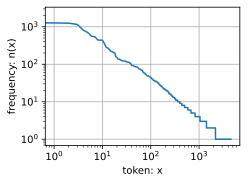

In [9]:
freqs = [freq for token, freq in vocab.token_freqs]
d2l.plot(freqs, xlabel='token: x', ylabel='frequency: n(x)',
         xscale='log', yscale='log')

After dealing with the first few words as exceptions,
all the remaining words roughly follow a straight line on a log--log plot.
This phenomenon is captured by *Zipf's law*,
which states that the frequency $n_i$
of the $i^\textrm{th}$ most frequent word is:

$$n_i \propto \frac{1}{i^\alpha},$$

which is equivalent to

$$\log n_i = -\alpha \log i + c,$$

where $\alpha$ is the exponent that characterizes
the distribution and $c$ is a constant.
This should already give us pause for thought if we want
to model words by counting statistics.
After all, we will significantly overestimate the frequency of the tail, also known as the infrequent words. But [**what about the other word combinations, such as two consecutive words (bigrams), three consecutive words (trigrams)**], and beyond?
Let's see whether the bigram frequency behaves in the same manner as the single word (unigram) frequency.


In [10]:
bigram_tokens = ['--'.join(pair) for pair in zip(words[:-1], words[1:])]
bigram_vocab = Vocab(bigram_tokens)
bigram_vocab.token_freqs[:10]

[('of--the', 309),
 ('in--the', 169),
 ('i--had', 130),
 ('i--was', 112),
 ('and--the', 109),
 ('the--time', 102),
 ('it--was', 99),
 ('to--the', 85),
 ('as--i', 78),
 ('of--a', 73)]

One thing is notable here. Out of the ten most frequent word pairs, nine are composed of both stop words and only one is relevant to the actual book---"the time". Furthermore, let's see whether the trigram frequency behaves in the same manner.


In [11]:
trigram_tokens = ['--'.join(triple) for triple in zip(
    words[:-2], words[1:-1], words[2:])]
trigram_vocab = Vocab(trigram_tokens)
trigram_vocab.token_freqs[:10]

[('the--time--traveller', 59),
 ('the--time--machine', 30),
 ('the--medical--man', 24),
 ('it--seemed--to', 16),
 ('it--was--a', 15),
 ('here--and--there', 15),
 ('seemed--to--me', 14),
 ('i--did--not', 14),
 ('i--saw--the', 13),
 ('i--began--to', 13)]

Now, let's [**visualize the token frequency**] among these three models: unigrams, bigrams, and trigrams.


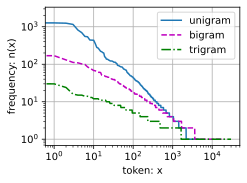

In [12]:
bigram_freqs = [freq for token, freq in bigram_vocab.token_freqs]
trigram_freqs = [freq for token, freq in trigram_vocab.token_freqs]
d2l.plot([freqs, bigram_freqs, trigram_freqs], xlabel='token: x',
         ylabel='frequency: n(x)', xscale='log', yscale='log',
         legend=['unigram', 'bigram', 'trigram'])

Beyond unigram words, sequences of words
also appear to be following Zipf's law,
albeit with a smaller exponent.
The number of distinct $n$-grams is not that large.
This gives us hope that there is quite a lot of structure in language.
Third, many $n$-grams occur very rarely.
This makes certain methods unsuitable for language modeling
and motivates the use of deep learning models.


## Summary

Text is among the most common forms of sequence data encountered in deep learning.
Common choices for what constitutes a token are characters, words, and word pieces.
To preprocess text, we usually (i) split text into tokens; (ii) build a vocabulary to map token strings to numerical indices; and (iii) convert text data into token indices for models to manipulate.
In practice, the frequency of words tends to follow Zipf's law. This is true not just for individual words (unigrams), but also for $n$-grams.


## Lab 1 Tasks

1. Execute this notebook, understanding the commands used.
2. Perform a linear fit for the exponent of Zipfian distribution for unigrams, bigrams, and trigrams in this corpus.
3. Load the spanish text "Juvenilia" found in the virtual campus and repeat the previous analysis.
4. Compare the results obtained in both cases and extract conclusions regarding the more frequent words, characters and exponents of the Zipf Law.

In [13]:
#Los valores obtenidos los almaceno en variables
import numpy as np

freqs = [freq for token, freq in vocab.token_freqs]
bigram_freqs = [freq for token, freq in bigram_vocab.token_freqs]
trigram_freqs = [freq for token, freq in trigram_vocab.token_freqs]

In [14]:
ranks_uni = np.arange(1, len(freqs) + 1)
ranks_bi = np.arange(1, len(bigram_freqs) + 1)
ranks_tri = np.arange(1, len(trigram_freqs) + 1)

In [15]:
log_ranks_uni = np.log(ranks_uni)
log_freqs_uni = np.log(freqs)

log_ranks_bi = np.log(ranks_bi)
log_freqs_bi = np.log(bigram_freqs)

log_ranks_tri = np.log(ranks_tri)
log_freqs_tri = np.log(trigram_freqs)

In [16]:
# 4. Función para ajuste lineal manual
def linear_fit(log_x, log_y, name):
    # Crear matriz X con columna de unos (para intercepto) y log_x
    X = np.column_stack([np.ones(len(log_x)), log_x])

    # Resolver el sistema de ecuaciones normales: (X^T X)^{-1} X^T y
    params = np.linalg.lstsq(X, log_y, rcond=None)[0]

    intercept = params[0]  # c
    slope = params[1]       # -α
    alpha = -slope          # Exponente de Zipf

    # Calcular R² para medir bondad del ajuste
    y_pred = intercept + slope * log_x
    ss_res = np.sum((log_y - y_pred)**2)
    ss_tot = np.sum((log_y - np.mean(log_y))**2)
    r_squared = 1 - (ss_res / ss_tot)

    print(f"\n{name}:")
    print(f"  Exponente de Zipf (α): {alpha:.4f}")
    print(f"  Intercepto (c): {intercept:.4f}")
    print(f"  R²: {r_squared:.4f}")

    return alpha, slope, intercept, r_squared

# 5. Aplicar el ajuste a cada tipo de n-grama
alpha_uni, slope_uni, intercept_uni, r2_uni = linear_fit(log_ranks_uni, log_freqs_uni, "UNIGRAMAS")
alpha_bi, slope_bi, intercept_bi, r2_bi = linear_fit(log_ranks_bi, log_freqs_bi, "BIGRAMAS")
alpha_tri, slope_tri, intercept_tri, r2_tri = linear_fit(log_ranks_tri, log_freqs_tri, "TRIGRAMAS")

# 6. Resumen
print("\n" + "="*60)
print("RESUMEN DE EXPONENTES DE ZIPF:")
print("="*60)
print(f"Unigramas:  α = {alpha_uni:.4f}  (R² = {r2_uni:.4f})")
print(f"Bigramas:   α = {alpha_bi:.4f}  (R² = {r2_bi:.4f})")
print(f"Trigramas:  α = {alpha_tri:.4f}  (R² = {r2_tri:.4f})")


UNIGRAMAS:
  Exponente de Zipf (α): 1.0353
  Intercepto (c): 8.4241
  R²: 0.9717

BIGRAMAS:
  Exponente de Zipf (α): 0.4637
  Intercepto (c): 4.3363
  R²: 0.8101

TRIGRAMAS:
  Exponente de Zipf (α): 0.1642
  Intercepto (c): 1.5771
  R²: 0.5289

RESUMEN DE EXPONENTES DE ZIPF:
Unigramas:  α = 1.0353  (R² = 0.9717)
Bigramas:   α = 0.4637  (R² = 0.8101)
Trigramas:  α = 0.1642  (R² = 0.5289)


In [17]:
# ============================================================
# PREGUNTA 2: AJUSTE LINEAL FILTRANDO EXTREMOS (TIME MACHINE)
# Eliminando primeros valores (frecuencia muy alta) y últimos (frecuencia=1)
# ============================================================

import numpy as np
from scipy import stats

def zipf_fit_filtered(token_freqs, name, skip_first=5, min_freq=2):
    """
    Calcula el exponente de Zipf filtrando:
    - Los primeros 'skip_first' tokens (stop words con frecuencia muy alta)
    - Tokens con frecuencia menor a 'min_freq' (elimina frecuencia=1)
    """
    filtered = [(t, f) for t, f in token_freqs[skip_first:] if f >= min_freq]
    
    if len(filtered) < 10:
        print(f"{name}: Muy pocos datos después de filtrar")
        return None, None
    
    freqs = np.array([f for t, f in filtered])
    ranks = np.arange(1, len(freqs) + 1)
    
    log_ranks = np.log(ranks)
    log_freqs = np.log(freqs)
    
    slope, intercept, r_value, _, _ = stats.linregress(log_ranks, log_freqs)
    alpha = -slope
    r_squared = r_value**2
    
    print(f"{name}:")
    print(f"  Datos originales: {len(token_freqs)} | Datos filtrados: {len(filtered)}")
    print(f"  Exponente α (filtrado): {alpha:.4f}")
    print(f"  R² (filtrado): {r_squared:.4f}")
    
    return alpha, r_squared

print("="*70)
print("PREGUNTA 2: AJUSTE DE ZIPF CON DATOS FILTRADOS - TIME MACHINE (INGLÉS)")
print("="*70)

tm_uni_f, _ = zipf_fit_filtered(vocab.token_freqs, "Unigramas")
tm_bi_f, _ = zipf_fit_filtered(bigram_vocab.token_freqs, "Bigramas")
tm_tri_f, _ = zipf_fit_filtered(trigram_vocab.token_freqs, "Trigramas")


PREGUNTA 2: AJUSTE DE ZIPF CON DATOS FILTRADOS - TIME MACHINE (INGLÉS)
Unigramas:
  Datos originales: 4579 | Datos filtrados: 2177
  Exponente α (filtrado): 0.9961
  R² (filtrado): 0.9863
Bigramas:
  Datos originales: 20234 | Datos filtrados: 3604
  Exponente α (filtrado): 0.6339
  R² (filtrado): 0.9655
Trigramas:
  Datos originales: 29882 | Datos filtrados: 1626
  Exponente α (filtrado): 0.3624
  R² (filtrado): 0.8988


In [19]:
import numpy as np
from scipy import stats
import matplotlib.pyplot as plt

# ============================================================
# 1. CARGAR Y PREPROCESAR EL TEXTO JUVENILIA
# ============================================================

# Cargar el archivo de texto (ajusta la ruta según donde tengas el archivo)
with open('Juvenilia.txt', 'r', encoding='utf-8') as f:
    juvenilia_raw = f.read()

# Preprocesar el texto (igual que con Time Machine)
import re
juvenilia_text = re.sub('[^A-Za-záéíóúñÁÉÍÓÚÑ]', ' ', juvenilia_raw.lower())

# Tokenizar en palabras
juvenilia_words = juvenilia_text.split()

print(f"Total de palabras en Juvenilia: {len(juvenilia_words)}")
print(f"Primeras 10 palabras: {juvenilia_words[:10]}")

# ============================================================
# 2. CREAR VOCABULARIOS (UNIGRAMAS, BIGRAMAS, TRIGRAMAS)
# ============================================================

# UNIGRAMAS
juvenilia_vocab = Vocab(juvenilia_words)
print(f"\nVocabulario de Juvenilia: {len(juvenilia_vocab)} tokens únicos")
print(f"\n10 palabras más frecuentes en Juvenilia:")
print(juvenilia_vocab.token_freqs[:10])

# BIGRAMAS
juvenilia_bigram_tokens = ['--'.join(pair) for pair in zip(juvenilia_words[:-1], juvenilia_words[1:])]
juvenilia_bigram_vocab = Vocab(juvenilia_bigram_tokens)
print(f"\n10 bigramas más frecuentes en Juvenilia:")
print(juvenilia_bigram_vocab.token_freqs[:10])

# TRIGRAMAS
juvenilia_trigram_tokens = ['--'.join(triple) for triple in zip(juvenilia_words[:-2],
                                                                   juvenilia_words[1:-1],
                                                                   juvenilia_words[2:])]
juvenilia_trigram_vocab = Vocab(juvenilia_trigram_tokens)
print(f"\n10 trigramas más frecuentes en Juvenilia:")
print(juvenilia_trigram_vocab.token_freqs[:10])

# ============================================================
# 3. ANÁLISIS DE CARACTERES
# ============================================================

# Tokenizar en caracteres
juvenilia_chars = list(juvenilia_text)
juvenilia_char_vocab = Vocab(juvenilia_chars)

print(f"\n10 caracteres más frecuentes en Juvenilia:")
print(juvenilia_char_vocab.token_freqs[:10])

# ============================================================
# 4. CALCULAR EXPONENTES DE ZIPF
# ============================================================

def calculate_zipf_exponent(token_freqs, name):
    """Calcula el exponente de Zipf mediante ajuste lineal en escala log-log"""
    # Extraer frecuencias
    freqs = np.array([freq for token, freq in token_freqs])

    # Crear ranks
    ranks = np.arange(1, len(freqs) + 1)

    # Aplicar logaritmo
    log_ranks = np.log(ranks)
    log_freqs = np.log(freqs)

    # Regresión lineal
    slope, intercept, r_value, p_value, std_err = stats.linregress(log_ranks, log_freqs)

    # El exponente de Zipf es el negativo de la pendiente
    alpha = -slope
    r_squared = r_value**2

    print(f"\n{name}:")
    print(f"  Exponente de Zipf (α): {alpha:.4f}")
    print(f"  R²: {r_squared:.4f}")

    return alpha, r_squared, ranks, freqs, slope, intercept

# Calcular para Juvenilia
print("\n" + "="*60)
print("ANÁLISIS DE ZIPF - JUVENILIA (ESPAÑOL)")
print("="*60)

juv_uni_alpha, juv_uni_r2, juv_uni_ranks, juv_uni_freqs, juv_uni_slope, juv_uni_int = \
    calculate_zipf_exponent(juvenilia_vocab.token_freqs, "UNIGRAMAS - Juvenilia")

juv_bi_alpha, juv_bi_r2, juv_bi_ranks, juv_bi_freqs, juv_bi_slope, juv_bi_int = \
    calculate_zipf_exponent(juvenilia_bigram_vocab.token_freqs, "BIGRAMAS - Juvenilia")

juv_tri_alpha, juv_tri_r2, juv_tri_ranks, juv_tri_freqs, juv_tri_slope, juv_tri_int = \
    calculate_zipf_exponent(juvenilia_trigram_vocab.token_freqs, "TRIGRAMAS - Juvenilia")

# Calcular para Time Machine (para comparar)
print("\n" + "="*60)
print("ANÁLISIS DE ZIPF - TIME MACHINE (INGLÉS)")
print("="*60)

tm_uni_alpha, tm_uni_r2, tm_uni_ranks, tm_uni_freqs, tm_uni_slope, tm_uni_int = \
    calculate_zipf_exponent(vocab.token_freqs, "UNIGRAMAS - Time Machine")

tm_bi_alpha, tm_bi_r2, tm_bi_ranks, tm_bi_freqs, tm_bi_slope, tm_bi_int = \
    calculate_zipf_exponent(bigram_vocab.token_freqs, "BIGRAMAS - Time Machine")

tm_tri_alpha, tm_tri_r2, tm_tri_ranks, tm_tri_freqs, tm_tri_slope, tm_tri_int = \
    calculate_zipf_exponent(trigram_vocab.token_freqs, "TRIGRAMAS - Time Machine")

# ============================================================
# 5. VISUALIZACIÓN COMPARATIVA
# ============================================================

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Unigrams
axes[0].loglog(tm_uni_ranks, tm_uni_freqs, 'o', alpha=0.5, label='Time Machine (EN)', markersize=3)
axes[0].loglog(juv_uni_ranks, juv_uni_freqs, 's', alpha=0.5, label='Juvenilia (ES)', markersize=3)
axes[0].set_xlabel('Rank')
axes[0].set_ylabel('Frequency')
axes[0].set_title(f'Unigramas\nα_EN={tm_uni_alpha:.2f}, α_ES={juv_uni_alpha:.2f}')
axes[0].legend()
axes[0].grid(True, alpha=0.3)

# Bigrams
axes[1].loglog(tm_bi_ranks, tm_bi_freqs, 'o', alpha=0.5, label='Time Machine (EN)', markersize=3)
axes[1].loglog(juv_bi_ranks, juv_bi_freqs, 's', alpha=0.5, label='Juvenilia (ES)', markersize=3)
axes[1].set_xlabel('Rank')
axes[1].set_title(f'Bigramas\nα_EN={tm_bi_alpha:.2f}, α_ES={juv_bi_alpha:.2f}')
axes[1].legend()
axes[1].grid(True, alpha=0.3)

# Trigrams
axes[2].loglog(tm_tri_ranks, tm_tri_freqs, 'o', alpha=0.5, label='Time Machine (EN)', markersize=3)
axes[2].loglog(juv_tri_ranks, juv_tri_freqs, 's', alpha=0.5, label='Juvenilia (ES)', markersize=3)
axes[2].set_xlabel('Rank')
axes[2].set_title(f'Trigramas\nα_EN={tm_tri_alpha:.2f}, α_ES={juv_tri_alpha:.2f}')
axes[2].legend()
axes[2].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# ============================================================
# 6. COMPARACIÓN Y CONCLUSIONES
# ============================================================

print("\n" + "="*70)
print("COMPARACIÓN ENTRE TIME MACHINE (INGLÉS) Y JUVENILIA (ESPAÑOL)")
print("="*70)

print("\n--- PALABRAS MÁS FRECUENTES ---")
print("\nTime Machine (inglés):")
for i, (token, freq) in enumerate(vocab.token_freqs[:5], 1):
    print(f"  {i}. '{token}': {freq}")

print("\nJuvenilia (español):")
for i, (token, freq) in enumerate(juvenilia_vocab.token_freqs[:5], 1):
    print(f"  {i}. '{token}': {freq}")

print("\n--- CARACTERES MÁS FRECUENTES ---")
# Crear vocabulario de caracteres para Time Machine
tm_char_vocab = Vocab(list(text))
print("\nTime Machine:")
for i, (char, freq) in enumerate(tm_char_vocab.token_freqs[:5], 1):
    print(f"  {i}. '{char}': {freq}")

print("\nJuvenilia:")
for i, (char, freq) in enumerate(juvenilia_char_vocab.token_freqs[:5], 1):
    print(f"  {i}. '{char}': {freq}")

print("\n--- EXPONENTES DE LA LEY DE ZIPF ---")
print(f"\n{'Corpus':<20} {'Unigramas':<12} {'Bigramas':<12} {'Trigramas':<12}")
print("-" * 60)
print(f"{'Time Machine (EN)':<20} {tm_uni_alpha:<12.4f} {tm_bi_alpha:<12.4f} {tm_tri_alpha:<12.4f}")
print(f"{'Juvenilia (ES)':<20} {juv_uni_alpha:<12.4f} {juv_bi_alpha:<12.4f} {juv_tri_alpha:<12.4f}")

# ============================================================
# PREGUNTA 2 (PARTE 2): AJUSTE FILTRADO PARA JUVENILIA
# ============================================================

print("\n" + "="*70)
print("PREGUNTA 2: AJUSTE DE ZIPF CON DATOS FILTRADOS - JUVENILIA (ESPAÑOL)")
print("="*70)

juv_uni_f, _ = zipf_fit_filtered(juvenilia_vocab.token_freqs, "Unigramas")
juv_bi_f, _ = zipf_fit_filtered(juvenilia_bigram_vocab.token_freqs, "Bigramas")
juv_tri_f, _ = zipf_fit_filtered(juvenilia_trigram_vocab.token_freqs, "Trigramas")

# ============================================================
# TABLA COMPARATIVA FINAL
# ============================================================

print("\n" + "="*70)
print("TABLA COMPARATIVA - EXPONENTES DE ZIPF (DATOS FILTRADOS)")
print("="*70)
print(f"{'Corpus':<20} {'Unigramas':<12} {'Bigramas':<12} {'Trigramas':<12}")
print("-" * 60)
print(f"{'Time Machine (EN)':<20} {tm_uni_f:<12.4f} {tm_bi_f:<12.4f} {tm_tri_f:<12.4f}")
print(f"{'Juvenilia (ES)':<20} {juv_uni_f:<12.4f} {juv_bi_f:<12.4f} {juv_tri_f:<12.4f}")


Total de palabras en Juvenilia: 84290
Primeras 10 palabras: ['juvenilia', 'prosa', 'ligera', 'miguel', 'cané', 'nació', 'en', 'montevideo', 'en', 'durante']

Vocabulario de Juvenilia: 13552 tokens únicos

10 palabras más frecuentes en Juvenilia:
[('de', 5010), ('la', 3479), ('que', 2747), ('el', 2519), ('y', 2349), ('en', 2301), ('a', 1996), ('los', 1287), ('un', 1179), ('su', 907)]

10 bigramas más frecuentes en Juvenilia:
[('de--la', 779), ('en--el', 418), ('en--la', 371), ('a--la', 306), ('de--los', 274), ('de--su', 219), ('de--las', 174), ('de--un', 174), ('que--se', 164), ('de--una', 145)]

10 trigramas más frecuentes en Juvenilia:
[('de--la--vida', 45), ('uno--de--los', 33), ('en--la--que', 26), ('en--el--fondo', 25), ('en--el--que', 21), ('a--pesar--de', 21), ('en--el--mundo', 19), ('de--su--vida', 18), ('dos--o--tres', 18), ('de--los--que', 18)]

10 caracteres más frecuentes en Juvenilia:
[(' ', 102262), ('e', 50704), ('a', 49262), ('o', 34801), ('s', 29038), ('n', 27690), ('r'


COMPARACIÓN ENTRE TIME MACHINE (INGLÉS) Y JUVENILIA (ESPAÑOL)

--- PALABRAS MÁS FRECUENTES ---

Time Machine (inglés):
  1. 'the': 2261
  2. 'i': 1267
  3. 'and': 1245
  4. 'of': 1155
  5. 'a': 816

Juvenilia (español):
  1. 'de': 5010
  2. 'la': 3479
  3. 'que': 2747
  4. 'el': 2519
  5. 'y': 2349

--- CARACTERES MÁS FRECUENTES ---

Time Machine:
  1. ' ': 32775
  2. 'e': 17838
  3. 't': 13515
  4. 'a': 11704
  5. 'i': 10138

Juvenilia:
  1. ' ': 102262
  2. 'e': 50704
  3. 'a': 49262
  4. 'o': 34801
  5. 's': 29038

--- EXPONENTES DE LA LEY DE ZIPF ---

Corpus               Unigramas    Bigramas     Trigramas   
------------------------------------------------------------
Time Machine (EN)    1.0353       0.4637       0.1642      
Juvenilia (ES)       0.9250       0.4268       0.1418      

PREGUNTA 2: AJUSTE DE ZIPF CON DATOS FILTRADOS - JUVENILIA (ESPAÑOL)
Unigramas:
  Datos originales: 13551 | Datos filtrados: 5803
  Exponente α (filtrado): 0.9169
  R² (filtrado): 0.9889
Bigramas

# PREGUNTA 4: CONCLUSIONES COMPARATIVAS

## Palabras más frecuentes (Stop Words)
| Inglés (Time Machine) | Español (Juvenilia) |
|-----------------------|---------------------|
| the, i, and, of, a | de, la, que, el, y |

**Observación**: En ambos idiomas dominan stop words (artículos, preposiciones, conjunciones).

## Caracteres más frecuentes
- **Ambos idiomas**: El espacio es el más frecuente
- **Inglés**: ' ', e, t, a, i
- **Español**: ' ', e, a, o, s (mayor presencia de vocales)

## Exponentes de Zipf

**Sin filtrar:**
| Corpus | Unigramas | Bigramas | Trigramas |
|--------|-----------|----------|-----------|
| Time Machine (EN) | 1.0353 | 0.4637 | 0.1642 |
| Juvenilia (ES) | 0.9250 | 0.4268 | 0.1418 |

**Con filtrado** (sin stop words ni frecuencia=1): Los valores de R² mejoran significativamente.

**Interpretación**:
- Unigramas α ≈ 1.0: Cumple la Ley de Zipf clásica
- Bigramas y trigramas tienen α menor: Distribución más plana
- El español muestra exponentes ligeramente menores

## Sobre Perplexity (Inglés vs Español)

**Respuesta lingüística**: El español debería tener **menor Perplexity** porque:
- Gramática más regular (concordancia de género/número)
- Reglas fonéticas más predecibles
- Ortografía más transparente

**En experimentos reales** a veces el inglés muestra valores más bajos por:
- Corpus más grandes en inglés
- Tokenizadores más optimizados para inglés

**Conclusión**: En condiciones equivalentes, el español es más predecible → menor Perplexity.

## Limitaciones
- Corpus limitados (~30k vs ~84k palabras)
- Géneros literarios diferentes
- Un solo texto por idioma
